#                                                                 water shortage

# 1- Importing Libraries

In [19]:
import pandas as pd
import numpy as np
import pandas as pd
import missingno as msno
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import LabelEncoder, StandardScaler

# 2-Data reading and processing

       2.1 Data reading and analysing

In [93]:

df_train = pd.read_csv("C:\\Users\\maale\\OneDrive\\Bureau\\hichathon\\X_train_Hi5.csv")
df_test = pd.read_csv("C:\\Users\\maale\\OneDrive\\Bureau\\hichathon\\X_test_Hi5.csv")


C:\Users\maale\AppData\Local\Temp\ipykernel_44424\2891896608.py:1: DtypeWarning: Columns (108,110,111,115,117,118,122,124,125) have mixed types. Specify dtype option on import or set low_memory=False.
  df_train = pd.read_csv("C:\\Users\\maale\\OneDrive\\Bureau\\hichathon\\X_train_Hi5.csv")
C:\Users\maale\AppData\Local\Temp\ipykernel_44424\2891896608.py:2: DtypeWarning: Columns (1,5,108,110,111,115,117,118,122,124,125) have mixed types. Specify dtype option on import or set low_memory=False.
  df_test = pd.read_csv("C:\\Users\\maale\\OneDrive\\Bureau\\hichathon\\X_test_Hi5.csv")


In [21]:
# Display general information about the columns
print("\nColumn information:")
print(df_train.info())
# Descriptive statistics for numerical columns
print("\nDescriptive statistics for numerical columns:")
print(df_train.describe())



Column information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2830316 entries, 0 to 2830315
Data columns (total 92 columns):
 #   Column                                Dtype  
---  ------                                -----  
 0   row_index                             float64
 1   piezo_station_department_code         object 
 2   piezo_station_update_date             object 
 3   piezo_station_investigation_depth     float64
 4   piezo_station_department_name         object 
 5   piezo_station_commune_code_insee      object 
 6   piezo_station_pe_label                object 
 7   piezo_station_bdlisa_codes            object 
 8   piezo_station_altitude                float64
 9   piezo_station_bss_code                object 
 10  piezo_station_commune_name            object 
 11  piezo_station_longitude               float64
 12  piezo_station_latitude                float64
 13  piezo_station_bss_id                  object 
 14  piezo_bss_code                        object 

       2.2 features treatment with more than 50% missing values

In [22]:
# Configuration to display all columns
pd.set_option('display.max_rows', None)  # Display all rows
pd.set_option('display.max_columns', None)  # Display all columns
pd.set_option('display.float_format', '{:.2f}'.format)  # Display percentages with 2 decimal places

# Check for missing values
print("\nColumns with missing values as a percentage:")
missing_values = df_train.isnull().sum()
total_rows = len(df_train)
missing_columns = missing_values[missing_values > 0]

if not missing_columns.empty:
    # Calculate the percentage of missing values
    missing_percentage = (missing_columns / total_rows) * 100

    # Create a DataFrame containing only the percentages
    missing_info = pd.DataFrame({
        "Percentage of Missing Values (%)": missing_percentage
    })

    print(missing_info)
    print(f"\nNumber of columns with missing values: {len(missing_columns)}")

    # Average percentage of missing values
    mean_missing_percentage = missing_percentage.mean()
    print(f"\nAverage percentage of missing values: {mean_missing_percentage:.2f}%")

    # Column with the highest percentage of missing values
    col_with_max_missing = missing_percentage.idxmax()
    max_missing_percentage = missing_percentage.max()
    print(f"\nColumn with the highest percentage of missing values: {col_with_max_missing} ({max_missing_percentage:.2f}%)")
else:
    print("No missing values detected.")



Columns with missing values as a percentage:
                                      Percentage of Missing Values (%)
piezo_station_pe_label                                            8.12
piezo_station_bdlisa_codes                                        4.99
piezo_producer_name                                               5.15
piezo_measure_nature_code                                         3.97
piezo_measure_nature_name                                         3.97
prelev_structure_code_0                                          19.53
prelev_usage_label_0                                             19.53
prelev_volume_obtention_mode_label_0                             19.53
prelev_structure_code_1                                          19.56
prelev_usage_label_1                                             19.56
prelev_volume_obtention_mode_label_1                             19.56
prelev_structure_code_2                                          19.64
prelev_usage_label_2           

In [23]:
# Calculate missing values
missing_values = df_train.isnull().sum()
total_rows = len(df_train)
missing_percentage = (missing_values / total_rows) * 100

# Filter columns with more than 50% missing values
columns_above_50 = missing_percentage[missing_percentage > 50]
print(f"\nNumber of columns with more than 50% missing values: {len(columns_above_50)}")

# Drop the columns
df_train = df_train.drop(columns=columns_above_50.index)
df_test = df_test.drop(columns=columns_above_50.index)



Number of columns with more than 50% missing values: 0


     2.3  prelevement data treatment

In [24]:
# Columns to analyze for missing values
cols_to_check = [
    "prelev_structure_code_0", "prelev_usage_label_0", "prelev_volume_obtention_mode_label_0",
    "prelev_longitude_0", "prelev_latitude_0", "prelev_commune_code_insee_0",
    "prelev_structure_code_1", "prelev_volume_1", "prelev_usage_label_1",
    "prelev_volume_obtention_mode_label_1", "prelev_longitude_1", "prelev_latitude_1",
    "prelev_commune_code_insee_1", "prelev_structure_code_2", "prelev_volume_2",
    "prelev_usage_label_2", "prelev_volume_obtention_mode_label_2", "prelev_longitude_2",
    "prelev_latitude_2", "prelev_commune_code_insee_2", "prelev_other_volume_sum"
]

# Create a subset of data containing only the selected columns
df_subset = df_train[cols_to_check]

In [25]:
# Calculate the percentage of rows with missing values
missing_rows = df_subset.isnull().any(axis=1)
missing_percentage = (missing_rows.sum() / len(df_subset)) * 100
print(f"Percentage of rows with missing values: {missing_percentage:.2f}%")
print(f"Original DataFrame size: {df_train.shape}")

Percentage of rows with missing values: 19.64%
Original DataFrame size: (2830316, 92)


We plot the missing values matrix and the heatmap of missing values correlations

<Figure size 1200x800 with 0 Axes>

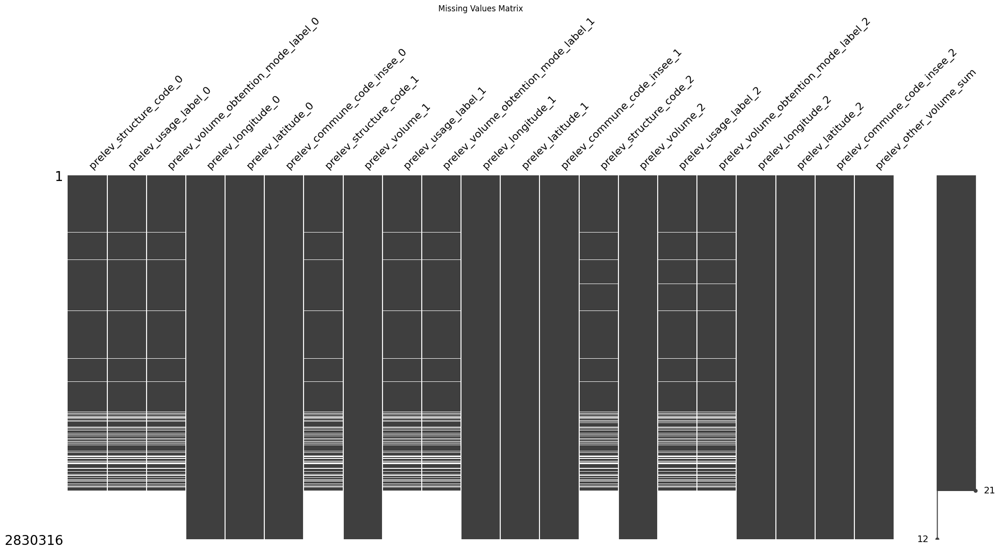

<Figure size 1200x800 with 0 Axes>

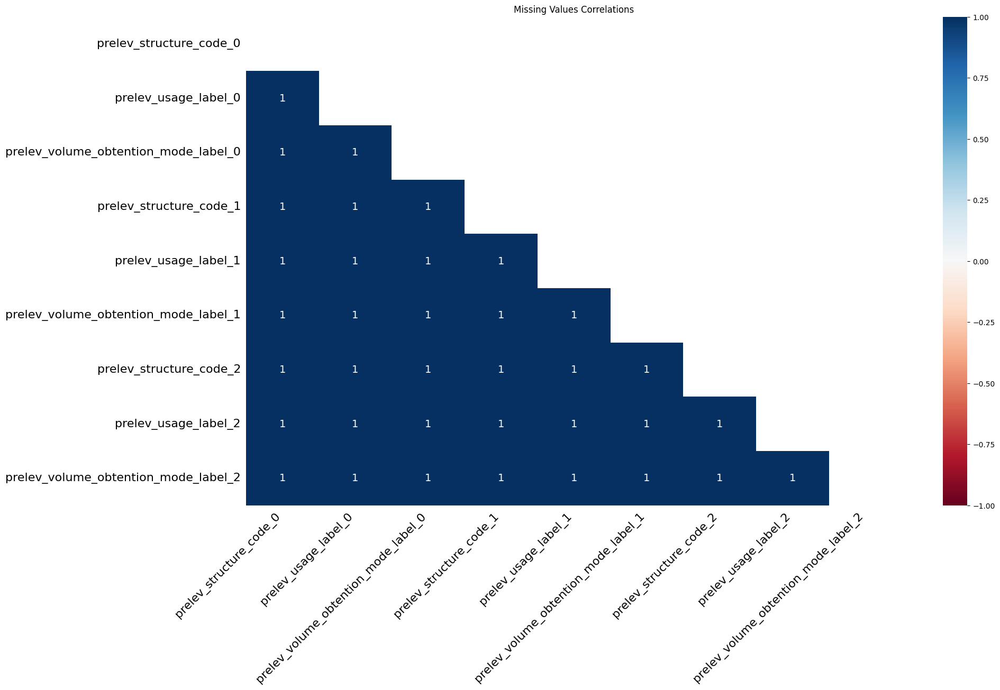

In [26]:
# Missing values matrix
plt.figure(figsize=(12, 8))
msno.matrix(df_subset)
plt.title("Missing Values Matrix")
plt.show()

# Heatmap of missing values correlations
plt.figure(figsize=(12, 8))
msno.heatmap(df_subset)
plt.title("Missing Values Correlations")
plt.show()


The correlation matrix between missing values shows that the columns are highly correlated so that shows that the missing values between the columns are in the same rows

In [ ]:
# Drop rows with missing values
df_train = df_train[~missing_rows]

print(f"Cleaned DataFrame size: {df_train.shape}")


Cleaned DataFrame size: (2274386, 92)


In [ ]:
from sklearn.experimental import enable_iterative_imputer  # Required to activate IterativeImputer
from sklearn.impute import IterativeImputer
from sklearn.linear_model import BayesianRidge

# Selecting numeric columns (integer and float types)
numeric_columns = df_train.select_dtypes(include=["int64", "float64"]).columns

# Initializing the imputer with BayesianRidge
bayesian_imputer = IterativeImputer(estimator=BayesianRidge(), imputation_order='ascending', random_state=42)

# Imputing numeric columns in the training and test datasets
df_train[numeric_columns] = bayesian_imputer.fit_transform(df_train[numeric_columns])
df_test[numeric_columns] = bayesian_imputer.transform(df_test[numeric_columns])

# Step 3: Winsorization to handle outliers
for col in numeric_columns:
    Q1 = df_train[col].quantile(0.25)  # First quartile (25%)
    Q3 = df_train[col].quantile(0.75)  # Third quartile (75%)
    IQR = Q3 - Q1  # Interquartile range
    lower_bound = Q1 - 1.5 * IQR  # Lower bound for outliers
    upper_bound = Q3 + 1.5 * IQR  # Upper bound for outliers
    df_train[col] = df_train[col].clip(lower=lower_bound, upper=upper_bound)  # Winsorize in training set
    df_test[col] = df_test[col].clip(lower=lower_bound, upper=upper_bound)    # Winsorize in test set

# Checking results
print("\nStatistics after processing numeric columns (train):")
print(df_train[numeric_columns].describe())

print("\nThe cleaned data has been successfully exported.")


We filter columns with high correlations and we display the heatmap for those high correlations

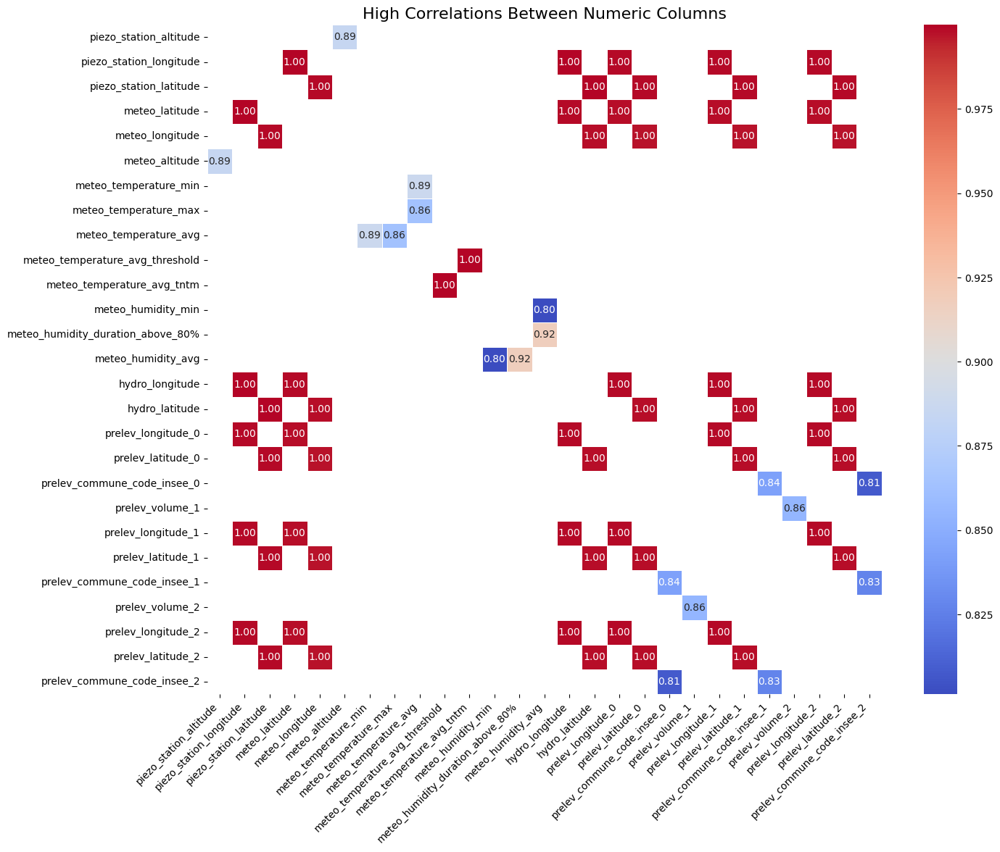

In [28]:
# Select numeric columns
numeric_columns = df_train.select_dtypes(include=["number"])

# Compute the correlation matrix
correlation_matrix = numeric_columns.corr()

# Filter for high correlations only (e.g., > 0.8 or < -0.8)
threshold = 0.8
high_corr = correlation_matrix[
    (correlation_matrix.abs() > threshold) & (correlation_matrix != 1.0)
].dropna(how="all", axis=0).dropna(how="all", axis=1)

# Display the heatmap for high correlations only
plt.figure(figsize=(15, 12))
sns.heatmap(high_corr, annot=True, fmt=".2f", cmap="coolwarm", cbar=True, linewidths=0.5)
plt.title("High Correlations Between Numeric Columns", fontsize=16)
plt.xticks(rotation=45, ha="right")
plt.yticks(rotation=0)
plt.show()


We remove the columns with high correlation

In [29]:
# Identify columns with high correlation
threshold = 0.8
correlated_features = set()
for i in range(len(correlation_matrix.columns)):
    for j in range(i):
        if abs(correlation_matrix.iloc[i, j]) > threshold:
            colname = correlation_matrix.columns[i]
            correlated_features.add(colname)
# Remove highly correlated columns
df_train_reduced = df_train.drop(columns=list(correlated_features))
df_test_reduced = df_test.drop(columns=list(correlated_features))
print(f"Highly correlated columns removed: {correlated_features}")


Highly correlated columns removed: {'meteo_latitude', 'meteo_temperature_avg', 'meteo_temperature_avg_tntm', 'hydro_longitude', 'prelev_longitude_2', 'prelev_latitude_0', 'meteo_humidity_avg', 'meteo_longitude', 'prelev_longitude_1', 'prelev_latitude_1', 'prelev_commune_code_insee_2', 'prelev_longitude_0', 'prelev_commune_code_insee_1', 'prelev_volume_2', 'hydro_latitude', 'meteo_altitude', 'prelev_latitude_2'}


In [ ]:
# We drop the row_index column
row_index_test = df_test_reduced['row_index']
df_train_reduced = df_train_reduced.drop(columns=['row_index'])
df_test_reduced = df_test_reduced.drop(columns=['row_index'])

 Numerical features normalisation

In [31]:
from sklearn.preprocessing import StandardScaler

# Extract numeric columns
numeric_columns = df_train_reduced.select_dtypes(include=["number"]).columns

# Initialize the scaler
scaler = StandardScaler()

# Apply standardization only to the remaining columns
df_train_reduced[numeric_columns] = scaler.fit_transform(df_train_reduced[numeric_columns])
df_test_reduced[numeric_columns] = scaler.transform(df_test_reduced[numeric_columns])

print("Numeric data successfully standardized.")


Numeric data successfully standardized.


     Target Treatment

In [32]:
# Extract the target variable
target_column = "piezo_groundwater_level_category"
y_train = df_train_reduced[target_column]

# Remove the target from datasets to avoid further processing
df_train_reduced = df_train_reduced.drop(columns=[target_column])
print(f"Target variable extracted: {target_column}")


Target variable extracted: piezo_groundwater_level_category


In [33]:
from sklearn.preprocessing import LabelEncoder

# Initialize the label encoder
label_encoder = LabelEncoder()

# Encode the classes
y_train_encoded = label_encoder.fit_transform(y_train)

print("Encoded classes:")
print(y_train_encoded)

# Display the corresponding classes
print("\nClass mappings:")
for index, class_label in enumerate(label_encoder.classes_):
    print(f"Encoded: {index} → Original class: {class_label}")


Encoded classes:
[1 3 1 ... 2 3 1]

Class mappings:
Encoded: 0 → Original class: Average
Encoded: 1 → Original class: High
Encoded: 2 → Original class: Low
Encoded: 3 → Original class: Very High
Encoded: 4 → Original class: Very Low


         Categorical features treatment

piezo_measurement_date Date variable treatment

In [34]:
# Convert to datetime if necessary
df_train_reduced['piezo_measurement_date'] = pd.to_datetime(df_train_reduced['piezo_measurement_date'], errors='coerce')
df_test_reduced['piezo_measurement_date'] = pd.to_datetime(df_test_reduced['piezo_measurement_date'], errors='coerce')

# Verify the conversion
print(df_train_reduced['piezo_measurement_date'].head())

# Extract temporal information
df_train_reduced['year'] = df_train_reduced['piezo_measurement_date'].dt.year
df_train_reduced['month'] = df_train_reduced['piezo_measurement_date'].dt.month
df_train_reduced['day'] = df_train_reduced['piezo_measurement_date'].dt.day

df_test_reduced['year'] = df_test_reduced['piezo_measurement_date'].dt.year
df_test_reduced['month'] = df_test_reduced['piezo_measurement_date'].dt.month
df_test_reduced['day'] = df_test_reduced['piezo_measurement_date'].dt.day

# Verification
print(df_train_reduced[['piezo_measurement_date', 'year', 'month', 'day']].head())

# Drop 'row_index' and 'piezo_measurement_date' from features
df_train_reduced = df_train_reduced.drop(columns=["piezo_measurement_date"])


0   2020-01-01
1   2020-01-01
2   2020-01-01
3   2020-01-01
4   2020-01-01
Name: piezo_measurement_date, dtype: datetime64[ns]
  piezo_measurement_date  year  month  day
0             2020-01-01  2020      1    1
1             2020-01-01  2020      1    1
2             2020-01-01  2020      1    1
3             2020-01-01  2020      1    1
4             2020-01-01  2020      1    1


In [51]:
df_test_reduced = df_test_reduced.drop(columns=["piezo_measurement_date"])


In [35]:
# Remove categorical columns with more than 1000 unique categories

# Identify categorical columns
categorical_columns = df_train_reduced.select_dtypes(include=["object", "category"]).columns

categorical_columns_to_drop = [
    col for col in categorical_columns
    if (df_train[col].nunique() > 1000) #and (col != "piezo_measurement_date")
]
columns_to_drop = categorical_columns_to_drop

# Drop the identified columns from the DataFrame
df_train_reduced = df_train_reduced.drop(columns=columns_to_drop)
df_test_reduced = df_test_reduced.drop(columns=columns_to_drop)

# Display the removed columns
print("\nRemoved columns :")
print(columns_to_drop)

# Dimensions after removal
print(f"\nDimensions after removal: {df_train_reduced.shape}")



Removed columns :
['piezo_station_commune_code_insee', 'piezo_station_pe_label', 'piezo_station_bss_code', 'piezo_station_commune_name', 'piezo_station_bss_id', 'piezo_bss_code', 'hydro_station_code', 'prelev_structure_code_0', 'prelev_structure_code_1', 'prelev_structure_code_2']

Dimensions after removal: (2274386, 65)


In [36]:
# List of date-type columns to exclude
columns_to_exclude = ['piezo_station_update_date', 'hydro_observation_date_elab','meteo_date']

# Exclude the columns
df_train_reduced = df_train_reduced.drop(columns=columns_to_exclude, errors='ignore')
df_test_reduced = df_test_reduced.drop(columns=columns_to_exclude, errors='ignore')


In [37]:
# Identify categorical columns, excluding specified variables
categorical_columns = df_train_reduced.select_dtypes(include=["object"]).columns

# Exclude 'piezo_groundwater_level_category' (target variable) and 'piezo_measurement_date' (time variable to be treated differently)
categorical_columns = [col for col in categorical_columns if col not in ["piezo_groundwater_level_category"]]

# Impute missing values for categorical columns by replacing them with the most frequent value
cat_imputer = SimpleImputer(strategy="most_frequent")
df_train_reduced[categorical_columns] = cat_imputer.fit_transform(df_train_reduced[categorical_columns])
df_test_reduced[categorical_columns] = cat_imputer.transform(df_test_reduced[categorical_columns])

print("Missing values imputed for categorical columns.")


Missing values imputed for categorical columns.


In [38]:
# Select numeric columns
numeric_columns = df_train_reduced.select_dtypes(include=["int64", "float64"]).columns
num_numeric_columns = len(numeric_columns)

# Select categorical columns
categorical_columns = df_train_reduced.select_dtypes(include=["object", "category"]).columns
num_categorical_columns = len(categorical_columns)

# Display the results
print(f"Number of numeric columns: {num_numeric_columns}")
print(f"Number of categorical columns: {num_categorical_columns}")


Number of numeric columns: 34
Number of categorical columns: 25


In [39]:
from sklearn.preprocessing import LabelEncoder

# Initialize label encoders
label_encoders = {}

# Encoding for each categorical column
for col in categorical_columns:
    le = LabelEncoder()
    
    # Encode train data
    df_train_reduced[col] = le.fit_transform(df_train_reduced[col])
    
    # Replace unknown categories in test data with "unknown"
    known_classes = list(le.classes_)
    df_test_reduced[col] = df_test_reduced[col].apply(lambda x: x if x in known_classes else "unknown")
    
    # Add "unknown" to the classes and encode test data
    le.classes_ = np.array(known_classes + ["unknown"])
    df_test_reduced[col] = le.transform(df_test_reduced[col])

    # Save the encoder
    label_encoders[col] = le

print("Encoding of categorical columns completed with handling of unknown categories.")


Encoding of categorical columns completed with handling of unknown categories.


In [41]:
columns=["meteo_name","meteo_id"]

df_train_reduced.drop(columns=columns,inplace=True)
df_test_reduced.drop(columns=columns,inplace=True)

In [42]:
df_train_reduced.shape

(2274386, 60)

In [43]:
df_train_reduced[['year','month','day']].head()

,year,month,day
0,2020,1,1
1,2020,1,1
2,2020,1,1
3,2020,1,1
4,2020,1,1


Data spliting into training and validation data for the model

In [44]:
from sklearn.model_selection import train_test_split

# Split the data into training and validation sets
X_train_split, X_val_split, y_train_split, y_val_split = train_test_split(
    df_train_reduced,   # Features
    y_train_encoded,    # Target
    test_size=0.2,      # 20% for validation
    random_state=42,    # Reproducibility
    stratify=y_train_encoded  # Maintain class distribution
)

# Check the sizes
print(f"Size of X_train_split: {X_train_split.shape}")
print(f"Size of X_val_split: {X_val_split.shape}")
print(f"Size of y_train_split: {y_train_split.shape}")
print(f"Size of y_val_split: {y_val_split.shape}")


Size of X_train_split: (1819508, 60)
Size of X_val_split: (454878, 60)
Size of y_train_split: (1819508,)
Size of y_val_split: (454878,)


# 3-Model training                       

In [45]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix , classification_report
from sklearn.model_selection import RandomizedSearchCV


In [72]:
# Best parameters from the grid search
best_params = {
    'n_estimators': 100,
    'min_samples_split': 10,
    'min_samples_leaf': 4,
    'max_features': 'sqrt',
    'max_depth': None,
    'bootstrap': False
}

# Initialize the Random Forest model with the best parameters
rf_model = RandomForestClassifier(
    n_estimators=best_params['n_estimators'],
    min_samples_split=best_params['min_samples_split'],
    min_samples_leaf=best_params['min_samples_leaf'],
    max_features=best_params['max_features'],
    max_depth=best_params['max_depth'],
    bootstrap=best_params['bootstrap'],
    random_state=42  )# For reproducibility

rf_model.fit(X_train_split, y_train_split)

# Evaluate the Model
y_pred = rf_model.predict(X_val_split)

print("Accuracy Score:")
print(accuracy_score(y_val_split, y_pred))

print("\nClassification Report:")
print(classification_report(y_val_split, y_pred))



Accuracy Score:
0.8863519449170987

Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.86      0.86    103953
           1       0.86      0.86      0.86     95632
           2       0.87      0.88      0.87     97091
           3       0.93      0.91      0.92     74201
           4       0.93      0.94      0.94     84001

    accuracy                           0.89    454878
   macro avg       0.89      0.89      0.89    454878
weighted avg       0.89      0.89      0.89    454878



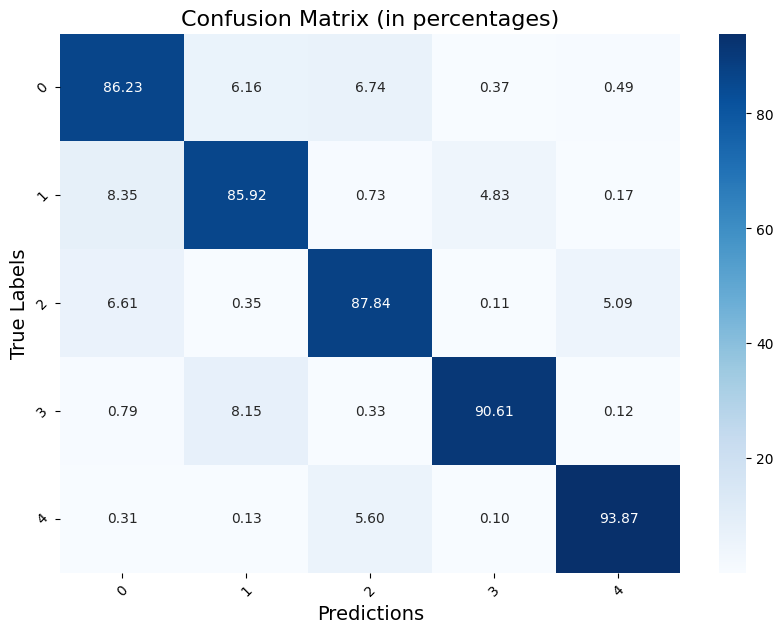

In [78]:
# Compute the confusion matrix
cm = confusion_matrix(y_val_split, y_pred)

# Normalize the confusion matrix by row
cm_percentage = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis] * 100

# Options for class labels (replace with your class labels if needed)
class_names = sorted(set(y_val_split))  # Sort unique classes

# Plot the confusion matrix as percentages
plt.figure(figsize=(10, 7))
sns.heatmap(
    cm_percentage, annot=True, fmt='.2f', cmap='Blues', 
    xticklabels=class_names, yticklabels=class_names
)

# Add titles and labels
plt.title('Confusion Matrix (in percentages)', fontsize=16)
plt.xlabel('Predictions', fontsize=14)
plt.ylabel('True Labels', fontsize=14)
plt.xticks(rotation=45)
plt.yticks(rotation=45)
plt.show()


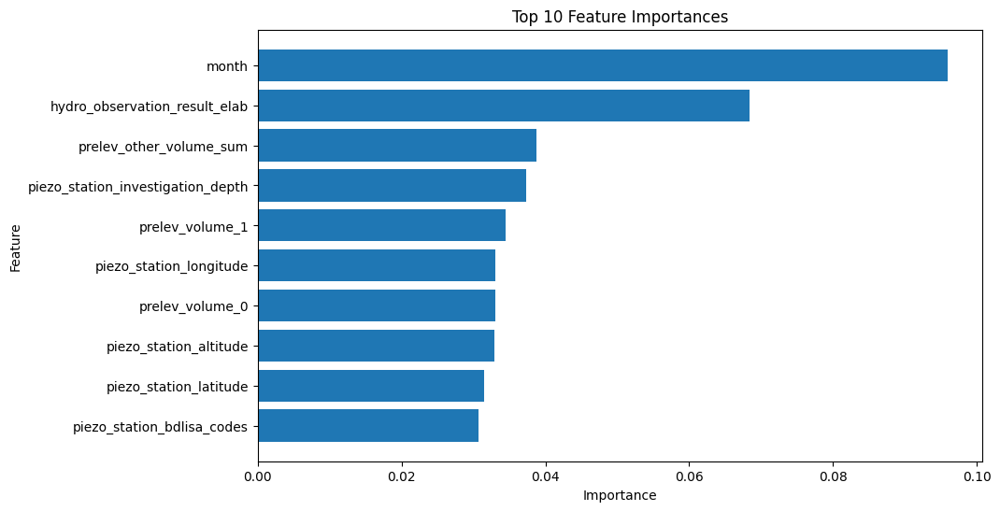

In [79]:
# Calculate feature importances
feature_importances = rf_model.feature_importances_

# Associate importances with column names
features = X_train_split.columns  # Column names in your training data
feature_importance_df = pd.DataFrame({
    'Feature': features,
    'Importance': feature_importances
})

# Sort features by descending importance
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

# Visualize the top 10 most important features
plt.figure(figsize=(10, 6))
plt.barh(feature_importance_df['Feature'][:10][::-1], feature_importance_df['Importance'][:10][::-1])
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Top 10 Feature Importances')
plt.show()


Hyperparameters tuning

In [ ]:
"""from sklearn.model_selection import RandomizedSearchCV


# --- Step 1: Sample the data ---
sample_size = 1000000  # Limit to 1M rows to reduce memory load
sample_indices = np.random.choice(X_train_split.shape[0], size=sample_size, replace=False)
X_train_sample = X_train_split.iloc[sample_indices]
y_train_sample = y_train_split[sample_indices]  # Direct indexing for NumPy array

# --- Step 2: Define the parameter grid ---
param_grid = {
    'n_estimators': [50, 100, 200, 300],  # Number of trees
    'max_depth': [10, 20, None],          # Maximum depth
    'min_samples_split': [2, 5, 10],      # Minimum samples to split a node
    'min_samples_leaf': [1, 2, 4],        # Minimum samples at leaf nodes
    'max_features': ['sqrt', 'log2'],     # Number of features considered
    'bootstrap': [True, False]            # Bootstrap sampling method
}

# --- Step 3: Initialize RandomizedSearchCV ---
rf_model = RandomForestClassifier(random_state=42)
grid_search = RandomizedSearchCV(
    estimator=rf_model,
    param_distributions=param_grid,
    n_iter=10,                   # Limit to 10 combinations
    scoring='accuracy',          # Use accuracy as the metric
    cv=3,                        # 3-fold cross-validation
    verbose=2,
    random_state=42,
    n_jobs=-1                    # Use all available cores
)

# --- Step 4: Fit on the sampled data ---
grid_search.fit(X_train_sample, y_train_sample)

# --- Step 5: Display the best parameters ---
print("Best parameters found:")
print(grid_search.best_params_)

# --- Step 6: Evaluate the model with the best parameters ---
best_model = grid_search.best_estimator_
y_val_pred = best_model.predict(X_val_split)

print("\nAccuracy Score on the validation set:")
print(accuracy_score(y_val_split, y_val_pred))

print("\nClassification Report on the validation set:")
print(classification_report(y_val_split, y_val_pred))"""


In [80]:
# Predict on the test data
predictions = rf_model.predict(df_test_reduced)

# Assuming row_index was saved separately
result = pd.DataFrame({
    'row_index': row_index_test,  # Original row indices
    'prediction': predictions     # Model predictions
})


In [81]:
result["row_index"] = result["row_index"].astype(int)
print(result.head())    


   row_index  prediction
0    2331795           0
1    2331796           1
2    2331797           0
3    2331798           1
4    2331799           0


In [82]:
class_mappings = {
    0: "Average",
    1: "High",
    2: "Low",
    3: "Very High",
    4: "Very Low"
}
# Conversion des prédictions numériques en chaînes
predictions_as_strings = [class_mappings[pred] for pred in predictions]

# Création du DataFrame final
result = pd.DataFrame({
    'row_index': result["row_index"],
    'piezo_groundwater_level_category': predictions_as_strings  # Classes en chaînes
})

# Sauvegarde ou affichage du résultat
result.to_csv("predictions_with_classes.csv", index=False)
print(result)


        row_index piezo_groundwater_level_category
0         2331795                          Average
1         2331796                             High
2         2331797                          Average
3         2331798                             High
4         2331799                          Average
5         2331800                          Average
6         2331801                             High
7         2331802                        Very High
8         2331803                         Very Low
9         2331804                             High
10        2331805                          Average
11        2331806                          Average
12        2331807                          Average
13        2331808                          Average
14        2331809                              Low
15        2331810                          Average
16        2331811                          Average
17        2331812                         Very Low
18        2331813              